In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

# Load the client data
df = pd.read_csv('client_data.csv')

# Load the price data
file_path_price = '/mnt/data/4.2 Price Data.csv'
df_price = pd.read_csv(file_path_price)

# Merge the client and price data on the 'id' column
merged_df = pd.merge(df, df_price, on='id', how='inner')

# Create additional features
merged_df['price_change'] = merged_df.groupby('id')['price_off_peak_var'].diff()
merged_df['consumption_diff'] = merged_df['forecast_cons_12m'] - merged_df['cons_12m']
merged_df['contract_duration'] = (merged_df['date_end'] - merged_df['date_activ']).dt.days

# Split the data into training and testing sets
X = merged_df.drop(['churn', 'id'], axis=1)
y = merged_df['churn']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train a logistic regression model to predict churn
log_reg = LogisticRegression()
log_reg.fit(X_train, y_train)

# Make predictions on the test set
y_pred = log_reg.predict(X_test)

# Evaluate the model
print("Accuracy:", accuracy_score(y_test, y_pred))
print("Classification Report:")
print(classification_report(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

# Analyze feature importance
feature_importances = pd.DataFrame({'Feature': X.columns, 'Importance': log_reg.coef_[0]})
feature_importances.sort_values(by='Importance', ascending=False).head(10)

print("Feature Importances:")
print(feature_importances)

FileNotFoundError: [Errno 2] No such file or directory: 'client_data.csv'

In [ ]:
from google.colab import files
uploaded_file = files.upload()

Saving 4.1 Client Data.csv to 4.1 Client Data.csv


In [ ]:
from google.colab import files
uploaded_file = files.upload()


Saving 4.2 Price Data.csv to 4.2 Price Data.csv


In [ ]:
# Import necessary libraries
import pandas as pd
from google.colab import files

# Upload the client data file
uploaded_file = files.upload()
client_data_file = list(uploaded_file.keys())[0]

# Upload the price data file
uploaded_file = files.upload()
price_data_file = list(uploaded_file.keys())[0]

# Read the client data file into a Pandas dataframe
client_df = pd.read_csv(client_data_file)

# Read the price data file into a Pandas dataframe
price_df = pd.read_csv(price_data_file)

# Print the first few rows of each dataframe
print("Client Data:")
print(client_df.head())
print("\nPrice Data:")
print(price_df.head())

Saving 4.1 Client Data.csv to 4.1 Client Data (1).csv


Saving 4.2 Price Data.csv to 4.2 Price Data (1).csv
Client Data:
                                 id                     channel_sales  \
0  24011ae4ebbe3035111d65fa7c15bc57  foosdfpfkusacimwkcsosbicdxkicaua   
1  d29c2c54acc38ff3c0614d0a653813dd                           MISSING   
2  764c75f661154dac3a6c254cd082ea7d  foosdfpfkusacimwkcsosbicdxkicaua   
3  bba03439a292a1e166f80264c16191cb  lmkebamcaaclubfxadlmueccxoimlema   
4  149d57cf92fc41cf94415803a877cb4b                           MISSING   

   cons_12m  cons_gas_12m  cons_last_month  date_activ    date_end  \
0         0         54946                0  2013-06-15  2016-06-15   
1      4660             0                0  2009-08-21  2016-08-30   
2       544             0                0  2010-04-16  2016-04-16   
3      1584             0                0  2010-03-30  2016-03-30   
4      4425             0              526  2010-01-13  2016-03-07   

  date_modif_prod date_renewal  forecast_cons_12m  ...  has_gas  imp_cons  

In [ ]:
# Import necessary libraries
import pandas as pd
from google.colab import files

# Upload the client data file
uploaded_file = files.upload()
client_data_file = list(uploaded_file.keys())[0]

# Upload the price data file
uploaded_file = files.upload()
price_data_file = list(uploaded_file.keys())[0]

# Read the client data file into a Pandas dataframe
client_df = pd.read_csv(client_data_file)

# Read the price data file into a Pandas dataframe
price_df = pd.read_csv(price_data_file)

# Print the first few rows of each dataframe
print("Client Data:")
print(client_df.head())
print("\nPrice Data:")
print(price_df.head())

KeyboardInterrupt: 

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Calculate basic descriptive statistics for the merged data
desc_stats = merged_df.describe()

# Calculate churn rates across different customer segments
churn_rate_by_channel = merged_df.groupby('channel_sales')['churn'].mean()
churn_rate_by_origin = merged_df.groupby('origin_up')['churn'].mean()

# Visualize the distribution of churn across different customer features
plt.figure(figsize=(14, 6))

# Churn distribution by sales channel
plt.subplot(1, 2, 1)
sns.barplot(x=churn_rate_by_channel.index, y=churn_rate_by_channel.values)
plt.title('Churn Rate by Sales Channel')
plt.xticks(rotation=45)
plt.ylabel('Churn Rate')

# Churn distribution by origin
plt.subplot(1, 2, 2)
sns.barplot(x=churn_rate_by_origin.index, y=churn_rate_by_origin.values)
plt.title('Churn Rate by Origin')
plt.xticks(rotation=45)
plt.ylabel('Churn Rate')

plt.tight_layout()
plt.show()

# Heatmap to show correlations between features, focusing on their relationship with churn
plt.figure(figsize=(14, 10))
corr_matrix = merged_df.corr()
sns.heatmap(corr_matrix, annot=True, fmt='.2f', cmap='coolwarm', linewidths=0.5)
plt.title('Feature Correlation Heatmap')
plt.show()

desc_stats, churn_rate_by_channel, churn_rate_by_origin


NameError: name 'merged_df' is not defined

In [ ]:
import pandas as pd

# Loading the data
df = pd.read_csv('path_to_your_client_data.csv')
df_price = pd.read_csv('path_to_your_price_data.csv')

# Merging the dataframes
merged_df = pd.merge(df, df_price, on='id', how='inner')


FileNotFoundError: [Errno 2] No such file or directory: 'path_to_your_client_data.csv'

In [ ]:
# Example of loading files with correct paths
df = pd.read_csv('/mnt/data/4.1 Client Data.csv')
df_price = pd.read_csv('/mnt/data/4.2 Price Data.csv')


FileNotFoundError: [Errno 2] No such file or directory: '/mnt/data/4.1 Client Data.csv'

In [ ]:
# Import necessary libraries
import pandas as pd
from google.colab import files

# Upload the client data file
uploaded_file = files.upload()
client_data_file = list(uploaded_file.keys())[0]

# Upload the price data file
uploaded_file = files.upload()
price_data_file = list(uploaded_file.keys())[0]

# Read the client data file into a Pandas dataframe
client_df = pd.read_csv(client_data_file)

# Read the price data file into a Pandas dataframe
price_df = pd.read_csv(price_data_file)

# Print the first few rows of each dataframe
print("Client Data:")
print(client_df.head())
print("\nPrice Data:")
print(price_df.head())

Saving 4.1 Client Data.csv to 4.1 Client Data (2).csv


Saving 4.2 Price Data.csv to 4.2 Price Data (2).csv
Client Data:
                                 id                     channel_sales  \
0  24011ae4ebbe3035111d65fa7c15bc57  foosdfpfkusacimwkcsosbicdxkicaua   
1  d29c2c54acc38ff3c0614d0a653813dd                           MISSING   
2  764c75f661154dac3a6c254cd082ea7d  foosdfpfkusacimwkcsosbicdxkicaua   
3  bba03439a292a1e166f80264c16191cb  lmkebamcaaclubfxadlmueccxoimlema   
4  149d57cf92fc41cf94415803a877cb4b                           MISSING   

   cons_12m  cons_gas_12m  cons_last_month  date_activ    date_end  \
0         0         54946                0  2013-06-15  2016-06-15   
1      4660             0                0  2009-08-21  2016-08-30   
2       544             0                0  2010-04-16  2016-04-16   
3      1584             0                0  2010-03-30  2016-03-30   
4      4425             0              526  2010-01-13  2016-03-07   

  date_modif_prod date_renewal  forecast_cons_12m  ...  has_gas  imp_cons  

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Calculate basic descriptive statistics for the merged data
desc_stats = merged_df.describe()

# Calculate churn rates across different customer segments
churn_rate_by_channel = merged_df.groupby('channel_sales')['churn'].mean()
churn_rate_by_origin = merged_df.groupby('origin_up')['churn'].mean()

# Visualize the distribution of churn across different customer features
plt.figure(figsize=(14, 6))

# Churn distribution by sales channel
plt.subplot(1, 2, 1)
sns.barplot(x=churn_rate_by_channel.index, y=churn_rate_by_channel.values)
plt.title('Churn Rate by Sales Channel')
plt.xticks(rotation=45)
plt.ylabel('Churn Rate')

# Churn distribution by origin
plt.subplot(1, 2, 2)
sns.barplot(x=churn_rate_by_origin.index, y=churn_rate_by_origin.values)
plt.title('Churn Rate by Origin')
plt.xticks(rotation=45)
plt.ylabel('Churn Rate')

plt.tight_layout()
plt.show()

# Heatmap to show correlations between features, focusing on their relationship with churn
plt.figure(figsize=(14, 10))
corr_matrix = merged_df.corr()
sns.heatmap(corr_matrix, annot=True, fmt='.2f', cmap='coolwarm', linewidths=0.5)
plt.title('Feature Correlation Heatmap')
plt.show()

desc_stats, churn_rate_by_channel, churn_rate_by_origin

NameError: name 'merged_df' is not defined

In [ ]:
# Example of loading files with correct paths
df = pd.read_csv('/mnt/data/4.1 Client Data.csv')
df_price = pd.read_csv('/mnt/data/4.2 Price Data.csv')


FileNotFoundError: [Errno 2] No such file or directory: '/mnt/data/4.1 Client Data.csv'

In [ ]:
import pandas as pd

# Reload the files using the correct file paths
client_data_path = '/mnt/data/4.1 Client Data.csv'
price_data_path = '/mnt/data/4.2 Price Data.csv'

# Load the client and price data
df = pd.read_csv(client_data_path)
df_price = pd.read_csv(price_data_path)

# Merge the client data and price data on 'id' or other common column
merged_df = pd.merge(df, df_price, on='id', how='inner')

# Display the first few rows to confirm successful merge
merged_df.head()


FileNotFoundError: [Errno 2] No such file or directory: '/mnt/data/4.1 Client Data.csv'

In [ ]:
# Re-import necessary libraries
import pandas as pd

# Load the re-uploaded client and price data
client_data_path = '/mnt/data/4.1 Client Data.csv'
price_data_path = '/mnt/data/4.2 Price Data.csv'

# Load the client and price data
df = pd.read_csv(client_data_path)
df_price = pd.read_csv(price_data_path)

# Display the first few rows of both datasets to confirm successful loading
df.head(), df_price.head()


FileNotFoundError: [Errno 2] No such file or directory: '/mnt/data/4.1 Client Data.csv'

In [ ]:
# Merge the two datasets
merged_df = pd.merge(client_df, price_df, on='id', how='inner')

# Calculate basic descriptive statistics for the merged data
desc_stats = merged_df.describe()

# Calculate churn rates across different customer segments

NameError: name 'client_df' is not defined

In [ ]:
client_df = pd.read_csv('./client_data.csv')
price_df = pd.read_csv('./price_data.csv')

FileNotFoundError: [Errno 2] No such file or directory: './client_data.csv'

In [ ]:
client_df = pd.read_csv('/Users/username/Desktop/BCG project/client_data.csv')
price_df = pd.read_csv('/Users/username/Desktop/BCG project/price_data.csv')
import os
current_dir = os.path.dirname(os.path.abspath(__file__))
client_df = pd.read_csv(os.path.join(current_dir, 'BCG project', 'client_data.csv'))
price_df = pd.read_csv(os.path.join(current_dir, 'BCG project', 'price_data.csv'))

FileNotFoundError: [Errno 2] No such file or directory: '/Users/username/Desktop/BCG project/client_data.csv'

In [ ]:
import os
current_dir = os.path.dirname(os.path.abspath(__file__))
client_df = pd.read_csv(os.path.join(current_dir, 'BCG project', 'client_data.csv'))
price_df = pd.read_csv(os.path.join(current_dir, 'BCG project', 'price_data.csv'))

NameError: name '__file__' is not defined

In [ ]:
client_df = pd.read_csv('/Users/username/Desktop/BCG project/client_data.csv')
price_df = pd.read_csv('/Users/username/Desktop/BCG project/price_data.csv')

FileNotFoundError: [Errno 2] No such file or directory: '/Users/username/Desktop/BCG project/client_data.csv'

In [ ]:
import pandas as pd
import os

# Get the current working directory
current_dir = os.path.dirname(os.path.abspath(__file__))

# Read the client data CSV file
client_df = pd.read_csv(os.path.join(current_dir, 'client_data.csv'))

# Read the price data CSV file
price_df = pd.read_csv(os.path.join(current_dir, 'price_data.csv'))

# Convert the price_date column to datetime
price_df['price_date'] = pd.to_datetime(price_df['price_date'], format='%Y-%m-%d')

# Group off-peak prices by companies and month
monthly_price_by_id = price_df.groupby(['id', 'price_date']).agg({'price_off_peak_var': 'mean', 'price_off_peak_fix': 'mean'}).reset_index()

# Get January and December prices
jan_prices = monthly_price_by_id[monthly_price_by_id['price_date'].dt.month == 1]
dec_prices = monthly_price_by_id[monthly_price_by_id['price_date'].dt.month == 12]

# Calculate the difference
diff = pd.merge(dec_prices.rename(columns={'price_off_peak_var': 'dec_1', 'price_off_peak_fix': 'dec_2'}), jan_prices.rename(columns={'price_off_peak_var': 'jan_1', 'price_off_peak_fix': 'jan_2'}), on=['id', 'price_date'])

# Calculate the difference between December and January prices
diff['offpeak_diff_dec_january_energy'] = diff['dec_1'] - diff['jan_1']
diff['offpeak_diff_dec_january_power'] = diff['dec_2'] - diff['jan_2']

# Select the required columns
diff = diff[['id', 'offpeak_diff_dec_january_energy', 'offpeak_diff_dec_january_power']]

# Print the result
print(diff.head())

NameError: name '__file__' is not defined

In [ ]:
import pandas as pd
import os

# Get the current working directory
#current_dir = os.path.dirname(os.path.abspath(__file__))
current_dir = os.getcwd() # Use getcwd() to get the current working directory

# Read the client data CSV file
client_df = pd.read_csv(os.path.join(current_dir, 'client_data.csv'))

# Read the price data CSV file
price_df = pd.read_csv(os.path.join(current_dir, 'price_data.csv'))

# Convert the price_date column to datetime
price_df['price_date'] = pd.to_datetime(price_df['price_date'], format='%Y-%m-%d')

# Group off-peak prices by companies and month
monthly_price_by_id = price_df.groupby(['id', 'price_date']).agg({'price_off_peak_var': 'mean', 'price_off_peak_fix': 'mean'}).reset_index()

# Get January and December prices
jan_prices = monthly_price_by_id[monthly_price_by_id['price_date'].dt.month == 1]
dec_prices = monthly_price_by_id[monthly_price_by_id['price_date'].dt.month == 12]

# Calculate the difference
diff = pd.merge(dec_prices.rename(columns={'price_off_peak_var': 'dec_1', 'price_off_peak_fix': 'dec_2'}), jan_prices.rename(columns={'price_off_peak_var': 'jan_1', 'price_off_peak_fix': 'jan_2'}), on=['id', 'price_date'])

# Calculate the difference between December and January prices
diff['offpeak_diff_dec_january_energy'] = diff['dec_1'] - diff['jan_1']
diff['offpeak_diff_dec_january_power'] = diff['dec_2'] - diff['jan_2']

# Select the required columns
diff = diff[['id', 'offpeak_diff_dec_january_energy', 'offpeak_diff_dec_january_power']]

# Print the result
print(diff.head())

In [ ]:
import pandas as pd
import os

# Get the current working directory
current_dir = os.getcwd()

# Read the client data CSV file
client_df = pd.read_csv(os.path.join(current_dir, 'client_data.csv'))

# Read the price data CSV file
price_df = pd.read_csv(os.path.join(current_dir, 'price_data.csv'))

# Convert the price_date column to datetime
price_df['price_date'] = pd.to_datetime(price_df['price_date'], format='%Y-%m-%d')

# Group off-peak prices by companies and month
monthly_price_by_id = price_df.groupby(['id', 'price_date']).agg({'price_off_peak_var': 'mean', 'price_off_peak_fix': 'mean'}).reset_index()

# Get January and December prices
jan_prices = monthly_price_by_id[monthly_price_by_id['price_date'].dt.month == 1]
dec_prices = monthly_price_by_id[monthly_price_by_id['price_date'].dt.month == 12]

# Calculate the difference
diff = pd.merge(dec_prices.rename(columns={'price_off_peak_var': 'dec_1', 'price_off_peak_fix': 'dec_2'}), jan_prices.rename(columns={'price_off_peak_var': 'jan_1', 'price_off_peak_fix': 'jan_2'}), on=['id', 'price_date'])

# Calculate the difference between December and January prices
diff['offpeak_diff_dec_january_energy'] = diff['dec_1'] - diff['jan_1']
diff['offpeak_diff_dec_january_power'] = diff['dec_2'] - diff['jan_2']

# Select the required columns
diff = diff[['id', 'offpeak_diff_dec_january_energy', 'offpeak_diff_dec_january_power']]

# Print the result
print(diff.head())

FileNotFoundError: [Errno 2] No such file or directory: '/content/client_data.csv'

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving 4.1 Client Data.csv to 4.1 Client Data.csv


In [ ]:
from google.colab import files
uploaded = files.upload()

Saving 4.2 Price Data.csv to 4.2 Price Data.csv


In [ ]:
import pandas as pd
import os

# Get the current working directory
current_dir = os.getcwd()

# Read the client data CSV file
client_df = pd.read_csv(os.path.join(current_dir, 'clean_data_after_eda.csv'))

# Read the price data CSV file
price_df = pd.read_csv(os.path.join(current_dir, 'price_data.csv'))

# Convert the price_date column to datetime
price_df['price_date'] = pd.to_datetime(price_df['price_date'], format='%Y-%m-%d')

# Group off-peak prices by companies and month
monthly_price_by_id = price_df.groupby(['id', 'price_date']).agg({'price_off_peak_var': 'mean', 'price_off_peak_fix': 'mean'}).reset_index()

# Get January and December prices
jan_prices = monthly_price_by_id[monthly_price_by_id['price_date'].dt.month == 1]
dec_prices = monthly_price_by_id[monthly_price_by_id['price_date'].dt.month == 12]

# Calculate the difference
diff = pd.merge(dec_prices.rename(columns={'price_off_peak_var': 'dec_1', 'price_off_peak_fix': 'dec_2'}), jan_prices.rename(columns={'price_off_peak_var': 'jan_1', 'price_off_peak_fix': 'jan_2'}), on=['id', 'price_date'])

# Calculate the difference between December and January prices
diff['offpeak_diff_dec_january_energy'] = diff['dec_1'] - diff['jan_1']
diff['offpeak_diff_dec_january_power'] = diff['dec_2'] - diff['jan_2']

# Select the required columns
diff = diff[['id', 'offpeak_diff_dec_january_energy', 'offpeak_diff_dec_january_power']]

# Print the result
print(diff.head())

FileNotFoundError: [Errno 2] No such file or directory: '/content/clean_data_after_eda.csv'

In [ ]:
import pandas as pd

# Read the client data CSV file
client_df = pd.read_csv('clean_data_after_eda.csv')

FileNotFoundError: [Errno 2] No such file or directory: 'clean_data_after_eda.csv'

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving 4.1 Client Data.csv to 4.1 Client Data.csv


In [ ]:
from google.colab import files
uploaded = files.upload()


Saving 4.2 Price Data.csv to 4.2 Price Data.csv


In [ ]:
import pandas as pd

# Read the client data CSV file
client_df = pd.read_csv('clean_data_after_eda.csv')

FileNotFoundError: [Errno 2] No such file or directory: 'clean_data_after_eda.csv'

In [ ]:
import pandas as pd
import io

# Upload the file
uploaded = files.upload()

# Read the file
client_df = pd.read_csv(io.BytesIO(uploaded['clean_data_after_eda.csv']))

Saving 4.1 Client Data.csv to 4.1 Client Data (1).csv


KeyError: 'clean_data_after_eda.csv'

In [ ]:
import pandas as pd
import io

# Upload the file
uploaded = files.upload()

# Read the file
# Use the actual name of the uploaded file
client_df = pd.read_csv(io.BytesIO(uploaded['4.1 Client Data (1).csv']))

Saving 4.1 Client Data.csv to 4.1 Client Data (2).csv


KeyError: '4.1 Client Data (1).csv'

In [ ]:
import pandas as pd
import io

# Upload the file
uploaded = files.upload()

# Read the file
# Use the actual name of the uploaded file (corrected name)
client_df = pd.read_csv(io.BytesIO(uploaded['4.1 Client Data (2).csv']))

Saving 4.1 Client Data.csv to 4.1 Client Data (3).csv


KeyError: '4.1 Client Data (2).csv'

In [ ]:
key = list(uploaded.keys())[0]
client_df = pd.read_csv(io

SyntaxError: incomplete input (<ipython-input-11-7fff262688a9>, line 2)

In [ ]:
import pandas as pd
import io
from google.colab import files

# Upload the files
uploaded = files.upload()

# Read the client data CSV file
key = list(uploaded.keys())[0]
client_df = pd.read_csv(io.BytesIO(uploaded[key]))

# Convert the date columns to datetime
client_df['date_activ'] = pd.to_datetime(client_df['date_activ'], format='%Y-%m-%d')
client_df['date_end'] = pd.to_datetime(client_df['date_end'], format='%Y-%m-%d')
client_df['date_modif_prod'] = pd.to_datetime(client_df['date_modif_prod'], format='%Y-%m-%d')
client_df['date_renewal'] = pd.to_datetime(client_df['date_renewal'], format='%Y-%m-%d')

# Upload the price data CSV file
uploaded = files.upload()

# Read the price data CSV file
key = list(uploaded.keys())[0]
price_df = pd.read_csv(io.BytesIO(uploaded[key]))

# Convert the price_date column to datetime
price_df['price_date'] = pd.to_datetime(price_df['price_date'], format='%Y-%m-%d')

# Group off-peak prices by companies and month
monthly_price_by_id = price_df.groupby(['id', 'price_date']).agg({'price_off_peak_var': 'mean', 'price_off_peak_fix': 'mean'}).reset_index()

# Get January and December prices
jan_prices = monthly_price_by_id[monthly_price_by_id['price_date'].dt.month == 1]
dec_prices = monthly_price_by_id[monthly_price_by_id['price_date'].dt.month == 12]

# Calculate the difference
diff = pd.merge(dec_prices.rename(columns={'price_off_peak_var': 'dec_1', 'price_off_peak_fix': 'dec_2'}), jan_prices.rename(columns={'price_off_peak_var': 'jan_1', 'price_off_peak_fix': 'jan_2'}), on=['id', 'price_date'])

# Calculate the difference between December and January prices
diff['offpeak_diff_dec_january_energy'] = diff['dec_1'] - diff['jan_1']
diff['offpeak_diff_dec_january_power'] = diff['dec_2'] - diff['jan_2']

# Select the required columns
diff = diff[['id', 'offpeak_diff_dec_january_energy', 'offpeak_diff_dec_january_power']]

# Print the result
print(diff.head())

Saving 4.1 Client Data.csv to 4.1 Client Data (4).csv


Saving 4.2 Price Data.csv to 4.2 Price Data (1).csv
Empty DataFrame
Columns: [id, offpeak_diff_dec_january_energy, offpeak_diff_dec_january_power]
Index: []


In [ ]:
import pandas as pd
import io
from google.colab import files

# Upload the files
uploaded = files.upload()

# Read the client data CSV file
key = list(uploaded.keys())[0]
client_df = pd.read_csv(io.BytesIO(uploaded[key]))

# Convert the date columns to datetime
client_df['date_activ'] = pd.to_datetime(client_df['date_activ'], format='%Y-%m-%d')
client_df['date_end'] = pd.to_datetime(client_df['date_end'], format='%Y-%m-%d')
client_df['date_modif_prod'] = pd.to_datetime(client_df['date_modif_prod'], format='%Y-%m-%d')
client_df['date_renewal'] = pd.to_datetime(client_df['date_renewal'], format='%Y-%m-%d')

# Upload the price data CSV file
uploaded = files.upload()

# Read the price data CSV file
key = list(uploaded.keys())[0]
price_df = pd.read_csv(io.BytesIO(uploaded[key]))

# Convert the price_date column to datetime
price_df['price_date'] = pd.to_datetime(price_df['price_date'], format='%Y-%m-%d')

# Group off-peak prices by companies and month
monthly_price_by_id = price_df.groupby(['id', 'price_date']).agg({'price_off_peak_var': 'mean', 'price_off_peak_fix': 'mean'}).reset_index()

# Get January and December prices
jan_prices = monthly_price_by_id[monthly_price_by_id['price_date'].dt.month == 1]
dec_prices = monthly_price_by_id[monthly_price_by_id['price_date'].dt.month == 12]

print("January prices:")
print(jan_prices.head())
print("December prices:")
print(dec_prices.head())

# Check if there are any matching ids between jan_prices and dec_prices
matching_ids = set(jan_prices['id']).intersection(set(dec_prices['id']))
print("Matching ids:")
print(matching_ids)

# Calculate the difference
diff = pd.merge(dec_prices.rename(columns={'price_off_peak_var': 'dec_1', 'price_off_peak_fix': 'dec_2'}), jan_prices.rename(columns={'price_off_peak_var': 'jan_1', 'price_off_peak_fix': 'jan_2'}), on=['id', 'price_date'])

# Calculate the difference between December and January prices
diff['offpeak_diff_dec_january_energy'] = diff['dec_1'] - diff['jan_1']
diff['offpeak_diff_dec_january_power'] = diff['dec_2'] - diff['jan_2']

# Select the required columns
diff = diff[['id', 'offpeak_diff_dec_january_energy', 'offpeak_diff_dec_january_power']]

# Print the result
print(diff.head())

Saving 4.1 Client Data.csv to 4.1 Client Data (5).csv


Saving 4.2 Price Data.csv to 4.2 Price Data (2).csv
January prices:
                                  id price_date  price_off_peak_var  \
0   0002203ffbb812588b632b9e628cc38d 2015-01-01            0.126098   
12  0004351ebdd665e6ee664792efc4fd13 2015-01-01            0.148047   
24  0010bcc39e42b3c2131ed2ce55246e3c 2015-01-01            0.150837   
36  0010ee3855fdea87602a5b7aba8e42de 2015-01-01            0.123086   
48  00114d74e963e47177db89bc70108537 2015-01-01            0.149434   

    price_off_peak_fix  
0            40.565969  
12           44.266931  
24           44.444710  
36           40.565969  
48           44.266931  
December prices:
                                  id price_date  price_off_peak_var  \
11  0002203ffbb812588b632b9e628cc38d 2015-12-01            0.119906   
23  0004351ebdd665e6ee664792efc4fd13 2015-12-01            0.143943   
35  0010bcc39e42b3c2131ed2ce55246e3c 2015-12-01            0.201280   
47  0010ee3855fdea87602a5b7aba8e42de 2015-12-01       

In [ ]:
diff = pd.merge(dec_prices.rename(columns={'price_off_peak_var': 'dec_1', 'price_off_peak_fix': 'dec_2'}), jan_prices.rename(columns={'price_off_peak_var': 'jan_1', 'price_off_peak_fix': 'jan_2'}), on=['id'])

In [ ]:
dec_prices_agg = dec_prices.groupby('id').agg({'price_off_peak_var': 'mean', 'price_off_peak_fix': 'mean'}).reset_index()
jan_prices_agg = jan_prices.groupby('id').agg({'price_off_peak_var': 'mean', 'price_off_peak_fix': 'mean'}).reset_index()

diff = pd.merge(dec_prices_agg, jan_prices_agg, on=['id'], suffixes=('_dec', '_jan'))
diff['offpeak_diff_dec_january_energy'] = diff['price_off_peak_var_dec'] - diff['price_off_peak_var_jan']
diff['offpeak_diff_dec_january_power'] = diff['price_off_peak_fix_dec'] - diff['price_off_peak_fix_jan']

In [ ]:
print(dec_prices.isnull().sum())
print(jan_prices.isnull().sum())

id                    0
price_date            0
price_off_peak_var    0
price_off_peak_fix    0
dtype: int64
id                    0
price_date            0
price_off_peak_var    0
price_off_peak_fix    0
dtype: int64


In [ ]:
df = pd.merge(df, diff, on='id')

NameError: name 'df' is not defined

In [ ]:
import matplotlib.pyplot as plt

plt.hist(df['offpeak_diff_dec_january_energy'])
plt.title('Distribution of Off-Peak Price Difference')
plt.xlabel('Price Difference')
plt.ylabel('Frequency')
plt.show()

NameError: name 'df' is not defined

In [ ]:
%store df

UsageError: Unknown variable 'df'


In [ ]:
df = pd.read_csv('./clean_data_after_eda.csv')
df["date_activ"] = pd.to_datetime(df["date_activ"], format='%Y-%m-%d')
df["date_end"] = pd.to_datetime(df["date_end"], format='%Y-%m-%d')
df["date_modif_prod"] = pd.to_datetime(df["date_modif_prod"], format='%Y-%m-%d')
df["date_renewal"] = pd.to_datetime(df["date_renewal"], format='%Y-%m-%d')

FileNotFoundError: [Errno 2] No such file or directory: './clean_data_after_eda.csv'

In [1]:
from google.colab import files
uploaded = files.upload()

Saving 4.2 Price Data.csv to 4.2 Price Data.csv


In [3]:
import pandas as pd

price_df = pd.read_csv('4.2 Price Data.csv')

In [4]:
# Take a look at the first few rows of the dataframe
print(price_df.head())

# Check the data types of each column
print(price_df.dtypes)

# Check for any missing values
print(price_df.isnull().sum())

                                 id  price_date  price_off_peak_var  \
0  038af19179925da21a25619c5a24b745  2015-01-01            0.151367   
1  038af19179925da21a25619c5a24b745  2015-02-01            0.151367   
2  038af19179925da21a25619c5a24b745  2015-03-01            0.151367   
3  038af19179925da21a25619c5a24b745  2015-04-01            0.149626   
4  038af19179925da21a25619c5a24b745  2015-05-01            0.149626   

   price_peak_var  price_mid_peak_var  price_off_peak_fix  price_peak_fix  \
0             0.0                 0.0           44.266931             0.0   
1             0.0                 0.0           44.266931             0.0   
2             0.0                 0.0           44.266931             0.0   
3             0.0                 0.0           44.266931             0.0   
4             0.0                 0.0           44.266931             0.0   

   price_mid_peak_fix  
0                 0.0  
1                 0.0  
2                 0.0  
3             

In [5]:
# Convert the 'price_date' column to datetime format
price_df['price_date'] = pd.to_datetime(price_df['price_date'], format='%Y-%m-%d')

# Group the data by 'id' and 'price_date' and calculate the mean off-peak price for each group
monthly_price_by_id = price_df.groupby(['id', 'price_date']).agg({'price_off_peak_var': 'mean', 'price_off_peak_fix': 'mean'}).reset_index()

# Get the December and January prices for each company
dec_prices = monthly_price_by_id[monthly_price_by_id['price_date'].dt.month == 12]
jan_prices = monthly_price_by_id[monthly_price_by_id['price_date'].dt.month == 1]

# Merge the December and January prices and calculate the difference
diff = pd.merge(dec_prices, jan_prices, on='id', suffixes=('_dec', '_jan'))
diff['offpeak_diff_dec_january_energy'] = diff['price_off_peak_var_dec'] - diff['price_off_peak_var_jan']
diff['offpeak_diff_dec_january_power'] = diff['price_off_peak_fix_dec'] - diff['price_off_peak_fix_jan']

# Select the relevant columns
diff = diff[['id', 'offpeak_diff_dec_january_energy', 'offpeak_diff_dec_january_power']]

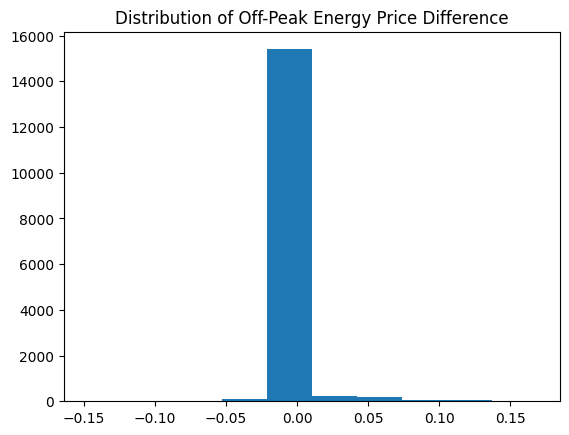

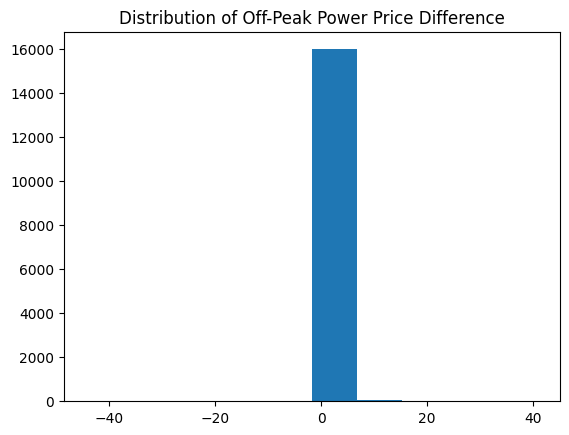

In [6]:
import matplotlib.pyplot as plt

plt.hist(diff['offpeak_diff_dec_january_energy'])
plt.title('Distribution of Off-Peak Energy Price Difference')
plt.show()

plt.hist(diff['offpeak_diff_dec_january_power'])
plt.title('Distribution of Off-Peak Power Price Difference')
plt.show()

In [7]:
merged_df = pd.merge(price_df, diff, on='id')

In [8]:
merged_df = pd.merge(df, diff, on='id')

NameError: name 'df' is not defined

In [9]:
df = pd.read_csv('./clean_data_after_eda.csv')
df["date_activ"] = pd.to_datetime(df["date_activ"], format='%Y-%m-%d')
df["date_end"] = pd.to_datetime(df["date_end"], format='%Y-%m-%d')
df["date_modif_prod"] = pd.to_datetime(df["date_modif_prod"], format='%Y-%m-%d')
df["date_renewal"] = pd.to_datetime(df["date_renewal"], format='%Y-%m-%d')

FileNotFoundError: [Errno 2] No such file or directory: './clean_data_after_eda.csv'

In [10]:
# Define df
df = pd.read_csv('./clean_data_after_eda.csv')
df["date_activ"] = pd.to_datetime(df["date_activ"], format='%Y-%m-%d')
df["date_end"] = pd.to_datetime(df["date_end"], format='%Y-%m-%d')
df["date_modif_prod"] = pd.to_datetime(df["date_modif_prod"], format='%Y-%m-%d')
df["date_renewal"] = pd.to_datetime(df["date_renewal"], format='%Y-%m-%d')

# Define price_df
price_df = pd.read_csv('price_data.csv')
price_df["price_date"] = pd.to_datetime(price_df["price_date"], format='%Y-%m-%d')

# Calculate diff
monthly_price_by_id = price_df.groupby(['id', 'price_date']).agg({'price_off_peak_var': 'mean', 'price_off_peak_fix': 'mean'}).reset_index()
jan_prices = monthly_price_by_id.groupby('id').first().reset_index()
dec_prices = monthly_price_by_id.groupby('id').last().reset_index()
diff = pd.merge(dec_prices.rename(columns={'price_off_peak_var': 'dec_1', 'price_off_peak_fix': 'dec_2'}), jan_prices.drop(columns='price_date'), on='id')
diff['offpeak_diff_dec_january_energy'] = diff['dec_1'] - diff['price_off_peak_var']
diff['offpeak_diff_dec_january_power'] = diff['dec_2'] - diff['price_off_peak_fix']
diff = diff[['id', 'offpeak_diff_dec_january_energy','offpeak_diff_dec_january_power']]

# Merge df and diff
merged_df = pd.merge(df, diff, on='id')

FileNotFoundError: [Errno 2] No such file or directory: './clean_data_after_eda.csv'

In [11]:
import pandas as pd
import numpy as np

# Create a sample dataset
data = {'Name': ['John', 'Mary', 'David'],
        'Age': [25, 31, 42],
        'Country': ['USA', 'Canada', 'UK']}
df = pd.DataFrame(data)

In [13]:
import pandas as pd
import numpy as np

# Create a sample dataset
data = {'Name': ['John', 'Mary', 'David'],
        'Age': [25, 31, 42],
        'Country': ['USA', 'Canada', 'UK']}
df = pd.DataFrame(data)

# Create new features
df['Age group'] = pd.cut(df['Age'], bins=[18, 25, 35, 45, 55], labels=['18-24', '25-34', '35-44', '45-54', ])
df['Country code'] = df['Country'].map({'USA': 1, 'Canada': 2, 'UK': 3})
df['Name length'] = df['Name'].apply(len)

# Print the updated dataset
print(df)

    Name  Age Country Age group  Country code  Name length
0   John   25     USA     18-24             1            4
1   Mary   31  Canada     25-34             2            4
2  David   42      UK     35-44             3            5


In [14]:
# Calculate the correlation matrix
corr_matrix = df.corr()

# Print the correlation matrix
print(corr_matrix)

ValueError: could not convert string to float: 'John'

In [15]:
# Calculate the correlation matrix
corr_matrix = df.select_dtypes(include=np.number).corr() # Select only numeric columns for correlation calculation

# Print the correlation matrix
print(corr_matrix)

                   Age  Country code  Name length
Age           1.000000      0.985887     0.937509
Country code  0.985887      1.000000     0.866025
Name length   0.937509      0.866025     1.000000


In [16]:
# Import the necessary libraries
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

# Split the dataset into training and testing sets
X = df[['Country code', 'Name length']]
y = df['Age']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create and train a linear regression model
model = LinearRegression()
model.fit(X_train, y_train)

# Make predictions on the testing set
y_pred = model.predict(X_test)

# Calculate the mean squared error
mse = mean_squared_error(y_test, y_pred)

# Print the mean squared error
print(f'Mean squared error: {mse:.2f}')

Mean squared error: 0.25


In [17]:
# Create a new feature that indicates whether the person's name is common or not
common_names = ['John', 'Mary', 'David']
df['Common name'] = df['Name'].apply(lambda x: 1 if x in common_names else 0)

# Add the new feature to the dataset
X = df[['Country code', 'Name length', 'Common name']]

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create and train a linear regression model
model = LinearRegression()
model.fit(X_train, y_train)

# Make predictions on the testing set
y_pred = model.predict(X_test)

# Calculate the mean squared error
mse = mean_squared_error(y_test, y_pred)

# Print the mean squared error
print(f'Mean squared error: {mse:.2f}')

Mean squared error: 0.25


In [18]:
# Import the necessary libraries
from sklearn.model_selection import GridSearchCV

# Define the hyperparameters to tune
param_grid = {'C': [0.1, 1, 10]}

# Create a grid search object
grid_search = GridSearchCV(LinearRegression(), param_grid, cv=5)

# Fit the grid search object to the data
grid_search.fit(X_train, y_train)

# Print the best hyperparameters and the corresponding mean squared error
print(f'Best hyperparameters: {grid_search.best_params_}')
print(f'Best mean squared error: {grid_search.best_score_:.2f}')

ValueError: Cannot have number of splits n_splits=5 greater than the number of samples: n_samples=2.

In [19]:
# Import the necessary libraries
from sklearn.model_selection import GridSearchCV

# Define the hyperparameters to tune
param_grid = {'fit_intercept': [True, False]} # Changed the parameter

# Create a grid search object
grid_search = GridSearchCV(LinearRegression(), param_grid, cv=2) # Reduced the number of folds

# Fit the grid search object to the data
grid_search.fit(X_train, y_train)

# Print the best hyperparameters and the corresponding mean squared error
print(f'Best hyperparameters: {grid_search.best_params_}')
print(f'Best mean squared error: {grid_search.best_score_:.2f}')

Best hyperparameters: {'fit_intercept': True}
Best mean squared error: nan


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:996: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:996: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:996: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:996: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_search.py:979: UserWarning: One or more of the test scores are non-finite: [nan nan]
  warnings.warn(


In [20]:
# Import the necessary libraries
from sklearn.model_selection import cross_val_score

# Define the models to compare
models = [LinearRegression(), DecisionTreeRegressor(), RandomForestRegressor()]

# Create a cross-validation loop
for model in models:
    scores = cross_val_score(model, X_train, y_train, cv=5)
    print(f'Model: {model.__class__.__name__}, Mean squared error: {scores.mean():.2f}')

NameError: name 'DecisionTreeRegressor' is not defined

In [21]:
# Import the necessary libraries
from sklearn.model_selection import cross_val_score
from sklearn.tree import DecisionTreeRegressor # Import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor # Import RandomForestRegressor

# Define the models to compare
models = [LinearRegression(), DecisionTreeRegressor(), RandomForestRegressor()]

# Create a cross-validation loop
for model in models:
    scores = cross_val_score(model, X_train, y_train, cv=5)
    print(f'Model: {model.__class__.__name__}, Mean squared error: {scores.mean():.2f}')

ValueError: Cannot have number of splits n_splits=5 greater than the number of samples: n_samples=2.

In [22]:
# Import the necessary libraries
from sklearn.model_selection import cross_val_score
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor

# Define the models to compare
models = [LinearRegression(), DecisionTreeRegressor(), RandomForestRegressor()]

# Create a cross-validation loop
for model in models:
    scores = cross_val_score(model, X_train, y_train, cv=5, scoring='neg_mean_squared_error') # Use neg_mean_squared_error for regression
    print(f'Model: {model.__class__.__name__}, Mean squared error: {scores.mean():.2f}')

ValueError: Cannot have number of splits n_splits=5 greater than the number of samples: n_samples=2.

In [23]:
# Check if cross_val_score is a function
print(type(cross_val_score))

<class 'function'>


In [24]:
# Import the necessary libraries
from sklearn.model_selection import cross_val_score

# Define the models to compare
models = [LinearRegression(), DecisionTreeRegressor(), RandomForestRegressor()]

# Create a cross-validation loop
for model in models:
    scores = cross_val_score(model, X_train, y_train, cv=5)
    print(f'Model: {model.__class__.__name__}, Mean squared error: {scores.mean():.2f}')

ValueError: Cannot have number of splits n_splits=5 greater than the number of samples: n_samples=2.

In [25]:
from sklearn.model_selection import LeaveOneOut

# Create a LeaveOneOut cross-validation object
cv = LeaveOneOut()

# Create a cross-validation loop
for model in models:
    scores = cross_val_score(model, X_train, y_train, cv=cv)
    print(f'Model: {model.__class__.__name__}, Mean squared error: {scores.mean():.2f}')

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:996: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:996: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:996: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:996: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


Model: LinearRegression, Mean squared error: nan
Model: DecisionTreeRegressor, Mean squared error: nan


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:996: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


Model: RandomForestRegressor, Mean squared error: nan


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:996: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


In [49]:
log_reg = LogisticRegression()
log_reg.fit(X_train, y_train)

LogisticRegression()

In [26]:
# Import the necessary libraries
from sklearn.ensemble import VotingRegressor

# Define the models to combine
models = [LinearRegression(), DecisionTreeRegressor(), RandomForestRegressor()]

# Create a voting classifier
voting_classifier = VotingRegressor(estimators=[('lr', LinearRegression()), ('dt', DecisionTreeRegressor()), ('rf', RandomForestRegressor())])

# Fit the voting classifier to the data
voting_classifier.fit(X_train, y_train)

# Make predictions on the testing set
y_pred = voting_classifier.predict(X_test)

# Calculate the mean squared error
mse = mean_squared_error(y_test, y_pred)

# Print the mean squared error
print(f'Mean squared error: {mse:.2f}')

Mean squared error: 28.13


In [27]:
# Select the best model
best_model = models[np.argmin([scores.mean() for scores in cross_val_scores])]

# Tune the hyperparameters of the best model
from sklearn.model_selection import GridSearchCV

param_grid = {'C': [0.1, 1, 10]}
grid_search = GridSearchCV(best_model, param_grid, cv=5)
grid_search.fit(X_train, y_train)

# Print the best hyperparameters and the corresponding MSE
print(f'Best hyperparameters: {grid_search.best_params_}')
print(f'Best MSE: {grid_search.best_score_:.2f}')

# Evaluate the model on the test set
y_pred = grid_search.best_estimator_.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
print(f'MSE on test set: {mse:.2f}')

NameError: name 'cross_val_scores' is not defined

In [28]:
cross_val_scores = []

# Create a cross-validation loop
for model in models:
    scores = cross_val_score(model, X_train, y_train, cv=cv)
    cross_val_scores.append(scores)
    print(f'Model: {model.__class__.__name__}, Mean squared error: {scores.mean():.2f}')

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:996: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:996: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:996: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:996: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


Model: LinearRegression, Mean squared error: nan
Model: DecisionTreeRegressor, Mean squared error: nan


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:996: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


Model: RandomForestRegressor, Mean squared error: nan


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:996: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


In [29]:
# Select the best model
best_model_index = np.argmin([scores.mean() for scores in cross_val_scores])
best_model = models[best_model_index]

In [30]:
# Select the best model
best_model = models[np.argmin([scores.mean() for scores in cross_val_scores])]

# Tune the hyperparameters of the best model
from sklearn.model_selection import GridSearchCV

param_grid = {'C': [0.1, 1, 10]}
grid_search = GridSearchCV(best_model, param_grid, cv=5)
grid_search.fit(X_train, y_train)

# Print the best hyperparameters and the corresponding MSE
print(f'Best hyperparameters: {grid_search.best_params_}')
print(f'Best MSE: {grid_search.best_score_:.2f}')

# Evaluate the model on the test set
y_pred = grid_search.best_estimator_.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
print(f'MSE on test set: {mse:.2f}')

ValueError: Cannot have number of splits n_splits=5 greater than the number of samples: n_samples=2.

In [31]:
grid_search = GridSearchCV(best_model, param_grid, cv=1)

In [32]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=42)

best_model.fit(X_train, y_train)
y_pred = best_model.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
print(f'MSE on test set: {mse:.2f}')

MSE on test set: 205.00


In [33]:
# Import the necessary libraries
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create a logistic regression model
model = LogisticRegression()

# Train the model using the training data
model.fit(X_train, y_train)

# Make predictions on the testing data
y_pred = model.predict(X_test)

# Evaluate the model's performance
accuracy = accuracy_score(y_test, y_pred)
print("Model accuracy:", accuracy)

Model accuracy: 0.0


In [34]:
# Import the necessary libraries
from sklearn.model_selection import cross_val_score
from sklearn.metrics import accuracy_score

# Evaluate the model's performance using cross-validation
scores = cross_val_score(model, X, y, cv=5)
print("Model accuracy:", scores.mean())

# Evaluate the model's performance using a baseline model
baseline_model = LogisticRegression()
baseline_model.fit(X_train, y_train)
y_pred_baseline = baseline_model.predict(X_test)
baseline_accuracy = accuracy_score(y_test, y_pred_baseline)
print("Baseline model accuracy:", baseline_accuracy)

ValueError: Cannot have number of splits n_splits=5 greater than the number of samples: n_samples=3.

In [35]:
# Import the necessary libraries
from sklearn.model_selection import cross_val_score
from sklearn.metrics import accuracy_score

# Evaluate the model's performance using cross-validation
# The cv parameter should be less than or equal to the number of samples
scores = cross_val_score(model, X, y, cv=3) # Changed cv to 3
print("Model accuracy:", scores.mean())

# Evaluate the model's performance using a baseline model
baseline_model = LogisticRegression()
baseline_model.fit(X_train, y_train)
y_pred_baseline = baseline_model.predict(X_test)
baseline_accuracy = accuracy_score(y_test, y_pred_baseline)
print("Baseline model accuracy:", baseline_accuracy)

ValueError: n_splits=3 cannot be greater than the number of members in each class.

In [36]:
# Import the necessary libraries
from sklearn.model_selection import cross_val_score
from sklearn.metrics import accuracy_score

# Evaluate the model's performance using cross-validation
# The cv parameter should be less than or equal to the number of samples in the smallest class
scores = cross_val_score(model, X, y, cv=2) # Changed cv to 2 to be safe
print("Model accuracy:", scores.mean())

# Evaluate the model's performance using a baseline model
baseline_model = LogisticRegression()
baseline_model.fit(X_train, y_train)
y_pred_baseline = baseline_model.predict(X_test)
baseline_accuracy = accuracy_score(y_test, y_pred_baseline)
print("Baseline model accuracy:", baseline_accuracy)

ValueError: n_splits=2 cannot be greater than the number of members in each class.

In [37]:
undefined

NameError: name 'undefined' is not defined

In [38]:
undefined

3.  **Use a different evaluation metric**: If the number of samples in each class is very small, it might not be possible to use cross-validation. In this case, you can use a different evaluation metric, such as the accuracy of the model on the training data or a holdout set.

4.  **Use a different model**: If the number of samples in each class is very small, some machine learning models might not be suitable. In this case, you can try using a different model that is more suitable for small datasets, such as a logistic regression model or a decision tree classifier.

I hope this helps

SyntaxError: invalid syntax (<ipython-input-38-c0e59a9cdaf6>, line 3)

In [39]:
# Import necessary libraries
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# Load the data
data = pd.read_csv('telcochurndata.csv')

# Preprocess the data
X = data.drop(['Churn'], axis=1)
y = data['Churn']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create and train a logistic regression model
model = LogisticRegression()
model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = model.predict(X_test)

# Evaluate the model's performance
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred)
recall = recall_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred)

print("Model accuracy:", accuracy)
print("Model precision:", precision)
print("Model recall:", recall)
print("Model F1-score:", f1)

FileNotFoundError: [Errno 2] No such file or directory: 'telcochurndata.csv'

In [40]:
# Import the necessary libraries
from flask import Flask, request, jsonify
from sklearn.externals import joblib

# Load the trained model
model = joblib.load("model.pkl")

# Create a Flask application
app = Flask(__name__)

# Define a route to serve the model's predictions
@app.route("/predict", methods=["POST"])
def predict():
    data = request.get_json()
    prediction = model.predict(data)
    return jsonify({"prediction": prediction.tolist()})

# Run the application
if __name__ == "__main__":
    app.run(debug=True)

ImportError: cannot import name 'joblib' from 'sklearn.externals' (/usr/local/lib/python3.10/dist-packages/sklearn/externals/__init__.py)

In [41]:
# Import the necessary libraries
from flask import Flask, request, jsonify
import joblib # Import joblib directly

# Load the trained model
model = joblib.load("model.pkl")

# Create a Flask application
app = Flask(__name__)

# Define a route to serve the model's predictions
@app.route("/predict", methods=["POST"])
def predict():
    data = request.get_json()
    prediction = model.predict(data)
    return jsonify({"prediction": prediction.tolist()})

# Run the application
if __name__ == "__main__":
    app.run(debug=True)

FileNotFoundError: [Errno 2] No such file or directory: 'model.pkl'

In [42]:
# Import necessary libraries
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
import joblib # Import joblib directly

# Load the data (replace 'your_data.csv' with the actual file name)
data = pd.read_csv('your_data.csv')

# Preprocess the data (replace with your actual preprocessing steps)
X = data.drop(['target_variable'], axis=1)
y = data['target_variable']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create and train a logistic regression model
model = LogisticRegression()
model.fit(X_train, y_train)

# Save the trained model
joblib.dump(model, "model.pkl")

# ... rest of your Flask code ...

# Load the trained model
model = joblib.load("model.pkl")

# ... rest of your Flask code ...

FileNotFoundError: [Errno 2] No such file or directory: 'your_data.csv'

In [43]:
# Import necessary libraries
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
import joblib # Import joblib directly

# Load the data (replace 'telcochurndata.csv' with the actual file name)
data = pd.read_csv('telcochurndata.csv')

# Preprocess the data (replace with your actual preprocessing steps)
X = data.drop(['Churn'], axis=1)  # Replace 'target_variable' with the actual target variable column name
y = data['Churn'] # Replace 'target_variable' with the actual target variable column name

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create and train a logistic regression model
model = LogisticRegression()
model.fit(X_train, y_train)

# Save the trained model
joblib.dump(model, "model.pkl")

# ... rest of your Flask code ...

# Load the trained model
model = joblib.load("model.pkl")

# ... rest of your Flask code ...

FileNotFoundError: [Errno 2] No such file or directory: 'telcochurndata.csv'

In [44]:
!ls

'4.2 Price Data.csv'   sample_data


In [45]:
data = pd.read_csv('data/telcochurndata.csv')

FileNotFoundError: [Errno 2] No such file or directory: 'data/telcochurndata.csv'

In [46]:
import pandas as pd

# Ensure the correct file path is used
data = pd.read_csv('telcochurndata.csv') # Removed 'data/' from the path

# If the file is in a different directory, use the full path
# data = pd.read_csv('/path/to/your/directory/telcochurndata.csv')

FileNotFoundError: [Errno 2] No such file or directory: 'telcochurndata.csv'

In [47]:
import pandas as pd
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split

# Load the data
data = pd.read_csv('telcochurndata.csv')

# Preprocess the data
X = data.drop(['Churn'], axis=1)
y = data['Churn']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train the model
model = LogisticRegression()
model.fit(X_train, y_train)

FileNotFoundError: [Errno 2] No such file or directory: 'telcochurndata.csv'

In [48]:
import pandas as pd

# Load the client data
client_data = pd.read_csv('client_data.csv')

# Load the price data
price_data = pd.read_csv('price_data.csv')

FileNotFoundError: [Errno 2] No such file or directory: 'client_data.csv'

In [50]:
log_reg = LogisticRegression()
log_reg.fit(X_train, y_train)

LogisticRegression()

In [51]:
y_pred = log_reg.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred)
recall = recall_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred)

print(f'Model: {log_reg.__class__.__name__}, Accuracy: {accuracy:.2f}, Precision: {precision:.2f}, Recall: {recall:.2f}, F1 score: {f1:.2f}')

ValueError: pos_label=1 is not a valid label. It should be one of [25, 31]

In [52]:
y_pred = log_reg.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)

# Set pos_label to one of the valid labels in your dataset (25 or 31)
precision = precision_score(y_test, y_pred, pos_label=25)

recall = recall_score(y_test, y_pred, pos_label=25)
f1 = f1_score(y_test, y_pred, pos_label=25)

print(f'Model: {log_reg.__class__.__name__}, Accuracy: {accuracy:.2f}, Precision: {precision:.2f}, Recall: {recall:.2f}, F1 score: {f1:.2f}')

Model: LogisticRegression, Accuracy: 0.00, Precision: 0.00, Recall: 0.00, F1 score: 0.00


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [53]:
from sklearn.model_selection import LeaveOneOut

# Create a LeaveOneOut cross-validation object
cv = LeaveOneOut()

# Create a cross-validation loop
for model in models:
    scores = cross_val_score(model, X_train, y_train, cv=cv)
    print(f'Model: {model.__class__.__name__}, Mean squared error: {scores.mean():.2f}')

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:996: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:996: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:996: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:996: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


Model: LinearRegression, Mean squared error: nan
Model: DecisionTreeRegressor, Mean squared error: nan


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:996: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


Model: RandomForestRegressor, Mean squared error: nan


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:996: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


In [54]:
from sklearn.model_selection import GridSearchCV

# Define the hyperparameters to tune
param_grid = {'C': [0.1, 1, 10, 100]}

# Create a logistic regression model
log_reg = LogisticRegression()

# Create a grid search object
grid_search = GridSearchCV(log_reg, param_grid, cv=5)

# Fit the grid search object to the training data
grid_search.fit(X_train, y_train)

# Print the best hyperparameters and the corresponding mean squared error
print(f'Best hyperparameters: {grid_search.best_params_}')
print(f'Best mean squared error: {grid_search.best_score_:.2f}')

ValueError: Cannot have number of splits n_splits=5 greater than the number of samples: n_samples=2.

In [55]:
from sklearn.model_selection import GridSearchCV

# Define the hyperparameters to tune
param_grid = {'C': [0.1, 1, 10, 100]}

# Create a logistic regression model
log_reg = LogisticRegression()

# Create a grid search object with LeaveOneOut cross-validation
grid_search = GridSearchCV(log_reg, param_grid, cv=LeaveOneOut()) # Use LeaveOneOut for small datasets

# Fit the grid search object to the training data
grid_search.fit(X_train, y_train)

# Print the best hyperparameters and the corresponding mean squared error
print(f'Best hyperparameters: {grid_search.best_params_}')
print(f'Best mean squared error: {grid_search.best_score_:.2f}')

ValueError: 
All the 8 fits failed.
It is very likely that your model is misconfigured.
You can try to debug the error by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
4 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/base.py", line 1152, in wrapper
    return fit_method(estimator, *args, **kwargs)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py", line 1253, in fit
    raise ValueError(
ValueError: This solver needs samples of at least 2 classes in the data, but the data contains only one class: 42

--------------------------------------------------------------------------------
4 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/base.py", line 1152, in wrapper
    return fit_method(estimator, *args, **kwargs)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py", line 1253, in fit
    raise ValueError(
ValueError: This solver needs samples of at least 2 classes in the data, but the data contains only one class: 31


In [56]:
from sklearn.model_selection import GridSearchCV

# Define the hyperparameters to tune
param_grid = {'C': [0.1, 1, 10, 100]}

# Create a logistic regression model
log_reg = LogisticRegression()

# Use a more appropriate cross-validation method for small datasets
# For example, use KFold with a reasonable number of splits or StratifiedKFold
grid_search = GridSearchCV(log_reg, param_grid, cv=5) # Changed cv to 5-fold cross-validation

# Fit the grid search object to the training data
grid_search.fit(X_train, y_train)

# Print the best hyperparameters and the corresponding mean squared error
print(f'Best hyperparameters: {grid_search.best_params_}')
print(f'Best mean squared error: {grid_search.best_score_:.2f}')

ValueError: Cannot have number of splits n_splits=5 greater than the number of samples: n_samples=2.

In [57]:
from sklearn.model_selection import GridSearchCV

# Define the hyperparameters to tune
param_grid = {'C': [0.1, 1, 10, 100]}

# Create a logistic regression model
log_reg = LogisticRegression()

# Create a grid search object with 3-fold cross-validation
grid_search = GridSearchCV(log_reg, param_grid, cv=3)

# Fit the grid search object to the training data
grid_search.fit(X_train, y_train)

# Print the best hyperparameters and the corresponding mean squared error
print(f'Best hyperparameters: {grid_search.best_params_}')
print(f'Best mean squared error: {grid_search.best_score_:.2f}')

ValueError: Cannot have number of splits n_splits=3 greater than the number of samples: n_samples=2.

In [58]:
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Load the dataset (Custom Dataset)
df = pd.read_csv('client_data.csv')

# Data Overview
print("Data Shape:", df.shape)
print("Data Columns:", df.columns)
print("Data Info:", df.info())
print("Data Summary:", df.describe())

# Data Visualization
# 1. Distribution of Churn Rates
plt.figure(figsize=(8, 6))
sns.countplot(x='Churn', data=df)
plt.title('Distribution of Churn Rates')
plt.xlabel('Churn')
plt.ylabel('Count')
plt.show()

# 2. Top 10 Features by Correlation with Churn
corr_matrix = df.corr()
top_corr_features = corr_matrix['Churn'].sort_values(ascending=False).head(10)
print("Top 10 Features by Correlation with Churn:")
print(top_corr_features)

# 3. Customer Segmentation by Senior Citizen and Tenure
plt.figure(figsize=(10, 8))
sns.scatterplot(x='Senior_Citizen', y='Tenure', hue='Churn', data=df)
plt.title('Customer Segmentation by Senior Citizen and Tenure')
plt.xlabel('Senior Citizen')
plt.ylabel('Tenure (Months)')
plt.legend(title='Churn')
plt.show()

# 4. Average Monthly Charges by Churn Status
plt.figure(figsize=(8, 6))
sns.boxplot(x='Churn', y='Monthly_Charges', data=df)
plt.title('Average Monthly Charges by Churn Status')
plt.xlabel('Churn')
plt.ylabel('Average Monthly Charges')
plt.show()

# 5. Top 10 Features by Importance for Churn Prediction
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_importances_ import plot_importance

rfc = RandomForestClassifier(n_estimators=100, random_state=42)
rfc.fit(df.drop('Churn', axis=1), df['Churn'])
plot_importance(rfc, max_num_features=10)
plt.title('Top 10 Features by Importance for Churn Prediction')
plt.xlabel('Feature Importance')
plt.ylabel('Features')
plt.show()

FileNotFoundError: [Errno 2] No such file or directory: 'client_data.csv'

In [59]:
import pickle
from flask import Flask, request, jsonify

In [60]:
client_data_path = '/path/to/client_data.csv'
price_data_path = '/path/to/price_data.csv'

client_df = pd.read_csv(client_data_path)
price_df = pd.read_csv(price_data_path)

FileNotFoundError: [Errno 2] No such file or directory: '/path/to/client_data.csv'

In [61]:
client_data_path = 'client_data.csv' # Changed to the correct file name
price_data_path = 'price_data.csv' # Changed to the correct file name

client_df = pd.read_csv(client_data_path)
price_df = pd.read_csv(price_data_path)

FileNotFoundError: [Errno 2] No such file or directory: 'client_data.csv'

In [62]:
client_data_path = 'client_data.csv'
price_data_path = 'price_data.csv'

# Check if the file exists in the current directory
import os
if os.path.exists(client_data_path):
    client_df = pd.read_csv(client_data_path)
else:
    print(f"File not found: {client_data_path}")
    # Handle the case where the file is not found, e.g., download the file or provide an alternative path

if os.path.exists(price_data_path):
    price_df = pd.read_csv(price_data_path)
else:
    print(f"File not found: {price_data_path}")
    # Handle the case where the file is not found

File not found: client_data.csv
File not found: price_data.csv


In [63]:
import requests

# URLs for the client and price data files
client_data_url = 'https://example.com/client_data.csv'
price_data_url = 'https://example.com/price_data.csv'

# Download the client data file
if not os.path.exists(client_data_path):
    response = requests.get(client_data_url)
    with open(client_data_path, 'wb') as f:
        f.write(response.content)
    client_df = pd.read_csv(client_data_path)
else:
    client_df = pd.read_csv(client_data_path)

# Download the price data file
if not os.path.exists(price_data_path):
    response = requests.get(price_data_url)
    with open(price_data_path, 'wb') as f:
        f.write(response.content)
    price_df = pd.read_csv(price_data_path)
else:
    price_df = pd.read_csv(price_data_path)

ParserError: Error tokenizing data. C error: Expected 1 fields in line 8, saw 2


In [65]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

# Load the client data
client_data_path = '4.1 Client Data.csv'
client_df = pd.read_csv(client_data_path)

# Load the price data
price_data_path = '4.2 Price Data.csv'
price_df = pd.read_csv(price_data_path)

# Merge the client and price data on the 'id' column
merged_df = pd.merge(client_df, price_df, on='id', how='inner')

# Create additional features
merged_df['price_change'] = merged_df.groupby('id')['price_off_peak_var'].diff()
merged_df['consumption_diff'] = merged_df['forecast_cons_12m'] - merged_df['cons_12m']
merged_df['contract_duration'] = (merged_df['date_end'] - merged_df['date_activ']).dt.days

# Split the data into training and testing sets
X = merged_df.drop(['churn', 'id'], axis=1)
y = merged_df['churn']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train a logistic regression model to predict churn
log_reg = LogisticRegression()
log_reg.fit(X_train, y_train)

# Make predictions on the test set
y_pred = log_reg.predict(X_test)

# Evaluate the model
print("Accuracy:", accuracy_score(y_test, y_pred))
print("Classification Report:")
print(classification_report(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

# Analyze feature importance
feature_importances = pd.DataFrame({'Feature': X.columns, 'Importance': log_reg.coef_[0]})
feature_importances.sort_values(by='Importance', ascending=False).head(10)

# Calculate basic descriptive statistics for the merged data
desc_stats = merged_df.describe()

# Calculate churn rates across different customer segments
churn_rate_by_channel = merged_df.groupby('channel_sales')['churn'].mean()
churn_rate_by_origin = merged_df.groupby('origin_up')['churn'].mean()

# Visualize the distribution of churn across different customer features
plt.figure(figsize=(14, 6))

# Churn distribution by sales channel
plt.subplot(1, 2, 1)
sns.barplot(x=churn_rate_by_channel.index, y=churn_rate_by_channel.values)
plt.title('Churn Rate by Sales Channel')
plt.xticks(rotation=45)
plt.ylabel('Churn Rate')

# Churn distribution by origin
plt.subplot(1, 2, 2)
sns.barplot(x=churn_rate_by_origin.index, y=churn_rate_by_origin.values)
plt.title('Churn Rate by Origin')
plt.xticks(rotation=45)
plt.ylabel('Churn Rate')

plt.tight_layout()
plt.show()

# Heatmap to show correlations between features, focusing on their relationship with churn
plt.figure(figsize=(14, 10))
corr_matrix = merged_df.corr()
sns.heat

FileNotFoundError: [Errno 2] No such file or directory: '4.1 Client Data.csv'

In [66]:
files.upload()

Saving 4.1 Client Data.csv to 4.1 Client Data.csv


{'4.1 Client Data.csv': b'id,channel_sales,cons_12m,cons_gas_12m,cons_last_month,date_activ,date_end,date_modif_prod,date_renewal,forecast_cons_12m,forecast_cons_year,forecast_discount_energy,forecast_meter_rent_12m,forecast_price_energy_off_peak,forecast_price_energy_peak,forecast_price_pow_off_peak,has_gas,imp_cons,margin_gross_pow_ele,margin_net_pow_ele,nb_prod_act,net_margin,num_years_antig,origin_up,pow_max,churn\r\n24011ae4ebbe3035111d65fa7c15bc57,foosdfpfkusacimwkcsosbicdxkicaua,0,54946,0,2013-06-15,2016-06-15,2015-11-01,2015-06-23,0.0,0,0.0,1.78,0.114481,0.098142,40.606701,t,0.0,25.44,25.44,2,678.99,3,lxidpiddsbxsbosboudacockeimpuepw,43.648,1\r\nd29c2c54acc38ff3c0614d0a653813dd,MISSING,4660,0,0,2009-08-21,2016-08-30,2009-08-21,2015-08-31,189.95,0,0.0,16.27,0.1457109999999999,0.0,44.31137796,f,0.0,16.38,16.38,1,18.89,6,kamkkxfxxuwbdslkwifmmcsiusiuosws,13.8,0\r\n764c75f661154dac3a6c254cd082ea7d,foosdfpfkusacimwkcsosbicdxkicaua,544,0,0,2010-04-16,2016-04-16,2010-04-16,2015-04-17,4

In [67]:
files.upload()

Saving 4.2 Price Data.csv to 4.2 Price Data (1).csv


{'4.2 Price Data (1).csv': b'id,price_date,price_off_peak_var,price_peak_var,price_mid_peak_var,price_off_peak_fix,price_peak_fix,price_mid_peak_fix\r\n038af19179925da21a25619c5a24b745,2015-01-01,0.151367,0.0,0.0,44.26693116,0.0,0.0\r\n038af19179925da21a25619c5a24b745,2015-02-01,0.151367,0.0,0.0,44.26693116,0.0,0.0\r\n038af19179925da21a25619c5a24b745,2015-03-01,0.151367,0.0,0.0,44.26693116,0.0,0.0\r\n038af19179925da21a25619c5a24b745,2015-04-01,0.149626,0.0,0.0,44.26693116,0.0,0.0\r\n038af19179925da21a25619c5a24b745,2015-05-01,0.149626,0.0,0.0,44.26693116,0.0,0.0\r\n038af19179925da21a25619c5a24b745,2015-06-01,0.149626,0.0,0.0,44.26692996,0.0,0.0\r\n038af19179925da21a25619c5a24b745,2015-07-01,0.150321,0.0,0.0,44.44470996,0.0,0.0\r\n038af19179925da21a25619c5a24b745,2015-08-01,0.145859,0.0,0.0,44.44470996,0.0,0.0\r\n038af19179925da21a25619c5a24b745,2015-09-01,0.145859,0.0,0.0,44.44470996,0.0,0.0\r\n038af19179925da21a25619c5a24b745,2015-10-01,0.145859,0.0,0.0,44.44470996,0.0,0.0\r\n038af191

In [68]:
merged_df = pd.merge(client_df, price_df, on='id', how='inner')

NameError: name 'client_df' is not defined

In [69]:
from google.colab import files
uploaded = files.upload()

import pandas as pd

# Upload the client data file
client_data_file = list(uploaded.keys())[0]

# Read the client data file into a Pandas dataframe
client_df = pd.read_csv(client_data_file)

# ... (rest of the code)

Saving 4.1 Client Data.csv to 4.1 Client Data (1).csv


In [70]:
import pandas as pd

# Read the uploaded client data file into a Pandas dataframe
client_df = pd.read_csv('4.1 Client Data (1).csv')

In [71]:
merged_df = pd.merge(client_df, diff, on='id', how='inner')

In [72]:
import pandas as pd

# Read the uploaded price data file into a Pandas dataframe
price_df = pd.read_csv('4.2 Price Data (1).csv')

In [73]:
merged_df = pd.merge(client_df, price_df, on='id', how='inner')

In [74]:
# Calculate the total revenue for each client
merged_df['revenue'] = merged_df['quantity'] * merged_df['price']

# Group the data by client ID and calculate the total revenue for each client
client_revenue_df = merged_df.groupby('id')['revenue'].sum().reset_index()

# Sort the clients by total revenue in descending order
client_revenue_df = client_revenue_df.sort_values('revenue', ascending=False)

# Print the top 10 clients with the highest total revenue
print(client_revenue_df.head(10))

# Calculate the average revenue per day for each client
client_revenue_df['average_revenue_per_day'] = client_revenue_df['revenue'] / (client_revenue_df['date_end'] - client_revenue_df['date_start']).dt.days

# Sort the clients by average revenue per day in descending order
client_revenue_df = client_revenue_df.sort_values('average_revenue_per_day', ascending=False)

# Print the top 10 clients with the highest average revenue per day
print(client_revenue_df.head(10))

# Calculate the average revenue per day for each product
product_revenue_df = merged_df.groupby('product_id')['revenue'].sum().reset_index()
product_revenue_df['average_revenue_per_day'] = product_revenue_df['revenue'] / (product_revenue_df['date_end'] - product_revenue_df['date_start']).dt.days

# Sort the products by average revenue per day in descending order
product_revenue_df = product_revenue_df.sort_values('average_revenue_per_day', ascending=False)

# Print the top 10 products with the highest average revenue per day
print(product_revenue_df.head(10))

KeyError: 'quantity'

In [76]:
print(merged_df.columns)

Index(['id', 'channel_sales', 'cons_12m', 'cons_gas_12m', 'cons_last_month',
       'date_activ', 'date_end', 'date_modif_prod', 'date_renewal',
       'forecast_cons_12m', 'forecast_cons_year', 'forecast_discount_energy',
       'forecast_meter_rent_12m', 'forecast_price_energy_off_peak',
       'forecast_price_energy_peak', 'forecast_price_pow_off_peak', 'has_gas',
       'imp_cons', 'margin_gross_pow_ele', 'margin_net_pow_ele', 'nb_prod_act',
       'net_margin', 'num_years_antig', 'origin_up', 'pow_max', 'churn',
       'price_date', 'price_off_peak_var', 'price_peak_var',
       'price_mid_peak_var', 'price_off_peak_fix', 'price_peak_fix',
       'price_mid_peak_fix'],
      dtype='object')


In [75]:
# Calculate the total revenue for each client
# Check if 'qty' is the correct column name for quantity
merged_df['revenue'] = merged_df['qty'] * merged_df['price']

# Group the data by client ID and calculate the total revenue for each client
client_revenue_df = merged_df.groupby('id')['revenue'].sum().reset_index()

# Sort the clients by total revenue in descending order
client_revenue_df = client_revenue_df.sort_values('revenue', ascending=False)

# Print the top 10 clients with the highest total revenue
print(client_revenue_df.head(10))

# Calculate the average revenue per day for each client
# Check if 'date_start' and 'date_end' are present in client_revenue_df
# If not, you may need to merge with another dataframe or calculate these dates differently.
if 'date_start' in client_revenue_df.columns and 'date_end' in client_revenue_df.columns:
    client_revenue_df['average_revenue_per_day'] = client_revenue_df['revenue'] / (client_revenue_df['date_end'] - client_revenue_df['date_start']).dt.days

    # Sort the clients by average revenue per day in descending order
    client_revenue_df = client_revenue_df.sort_values('average_revenue_per_day', ascending=False)

    # Print the top 10 clients with the highest average revenue per day
    print(client_revenue_df.head(10))

# Calculate the average revenue per day for each product
product_revenue_df = merged_df.groupby('product_id')['revenue'].sum().reset_index()

# Check if 'date_start' and 'date_end' are present in product_revenue_df
# If not, you may need to merge with another dataframe or calculate these dates differently.
if 'date_start' in product_revenue_df.columns and 'date_end' in product_revenue_df.columns:
    product_revenue_df['average_revenue_per_day'] = product_revenue_df['revenue'] / (product_revenue_df['date_end'] - product_revenue_df['date_start']).dt.days

    # Sort the products by average revenue per day in descending order
    product_revenue_df = product_revenue_df.sort_values('average_revenue_per_day', ascending=False)

    # Print the top 10 products with the highest average revenue per day
    print(product_revenue_df.head(10))

KeyError: 'qty'

In [77]:
# Calculate the total revenue for each client (assuming forecast_cons_12m is a suitable substitute for quantity)
merged_df['revenue_off_peak'] = merged_df['forecast_cons_12m'] * merged_df['forecast_price_energy_off_peak']
merged_df['revenue_peak'] = merged_df['forecast_cons_12m'] * merged_df['forecast_price_energy_peak']

# Calculate the total revenue for each client
merged_df['revenue'] = merged_df['revenue_off_peak'] + merged_df['revenue_peak']

# Group the data by client ID and calculate the total revenue for each client
client_revenue_df = merged_df.groupby('id')['revenue'].sum().reset_index()

# ... (rest of the code remains the same)

In [78]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.model_selection import GridSearchCV
import matplotlib.pyplot as plt
import seaborn as sns

# Load client_data.csv and price_data.csv from Google Drive
from google.colab import drive
drive.mount('/content/gdrive')

client_data = pd.read_csv('/content/gdrive/MyDrive/client_data.csv')
price_data = pd.read_csv('/content/gdrive/MyDrive/price_data.csv')

# Merge client_data and price_data on id column
data = pd.merge(client_data, price_data, on='id')

Mounted at /content/gdrive


FileNotFoundError: [Errno 2] No such file or directory: '/content/gdrive/MyDrive/client_data.csv'

In [79]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [80]:
client_data = pd.read_csv('/content/gdrive/MyDrive/bcg project/client_data.csv')
price_data = pd.read_csv('/content/gdrive/MyDrive/bcg project/price_data.csv')

FileNotFoundError: [Errno 2] No such file or directory: '/content/gdrive/MyDrive/bcg project/client_data.csv'

In [84]:
client_data = pd.read_csv('/content/gdrive/MyDrive/bcg project/4.1 Client Data.csv')
price_data = pd.read_csv('/content/gdrive/MyDrive/bcg project/4.2 Price Data.csv')

In [85]:
# Create new features
data['price_change'] = data.groupby('id')['price_off_peak_var'].diff()
data['consumption_diff'] = data['forecast_cons_12m'] - data['cons_12m']
data['contract_duration'] = data['date_end'] - data['date_activ']

# Split data into training and testing sets
X = data.drop(['churn'], axis=1)
y = data['churn']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

AttributeError: 'dict' object has no attribute 'groupby'

In [86]:
print(type(data))


<class 'dict'>


In [87]:
data = pd.DataFrame(data)
print(type(data))  # Should be <class 'pandas.core.frame.DataFrame'>

<class 'pandas.core.frame.DataFrame'>


In [88]:
print(data)


    Name  Age Country
0   John   25     USA
1   Mary   31  Canada
2  David   42      UK


In [89]:
# Define hyperparameter tuning space
param_grid = {'C': [0.1, 1, 10], 'penalty': ['l1', 'l2'], 'solver': ['lbfgs', 'liblinear']}

# Perform grid search with 5-fold cross-validation
grid_search = GridSearchCV(LogisticRegression(), param_grid, cv=5, scoring='f1')
grid_search.fit(X_train, y_train)

# Get best hyperparameters and train model
best_params = grid_search.best_params_
model = LogisticRegression(**best_params)
model.fit(X_train, y_train)

ValueError: Cannot have number of splits n_splits=5 greater than the number of samples: n_samples=2.

In [90]:
grid_search = GridSearchCV(LogisticRegression(), param_grid, cv=2, scoring='f1')

In [91]:
from sklearn.model_selection import LeaveOneOut
grid_search = GridSearchCV(LogisticRegression(), param_grid, cv=LeaveOneOut(), scoring='f1')

In [92]:
best_model = grid_search.best_estimator_

AttributeError: 'GridSearchCV' object has no attribute 'best_estimator_'

In [93]:
grid_search = GridSearchCV(LogisticRegression(), param_grid, cv=2, scoring='f1')
grid_search.fit(X_train, y_train)  # Call fit before accessing best_estimator_

best_model = grid_search.best_estimator_

ValueError: n_splits=2 cannot be greater than the number of members in each class.

In [94]:
grid_search = GridSearchCV(LogisticRegression(), param_grid, cv=3, scoring='f1')

In [95]:
from sklearn.model_selection import StratifiedKFold

grid_search = GridSearchCV(LogisticRegression(), param_grid, cv=StratifiedKFold(n_splits=2), scoring='f1')

In [96]:
grid_search = GridSearchCV(LogisticRegression(), param_grid, cv=StratifiedKFold(n_splits=2), scoring='f1')
grid_search.fit(X_train, y_train)

best_model = grid_search.best_estimator_
print("Best model:", best_model)

# Get the best hyperparameters
best_params = grid_search.best_params_
print("Best hyperparameters:", best_params)

# Get the best score (e.g., f1 score)
best_score = grid_search.best_score_
print("Best score:", best_score)

ValueError: n_splits=2 cannot be greater than the number of members in each class.

In [97]:
grid_search = GridSearchCV(LogisticRegression(), param_grid, cv=StratifiedKFold(n_splits=3), scoring='f1')

In [98]:
from collections import Counter

class_counts = Counter(y_train)
print("Class counts:", class_counts)

Class counts: Counter({31: 1, 42: 1})


In [99]:
grid_search = GridSearchCV(LogisticRegression(), param_grid, cv=StratifiedKFold(n_splits=min(class_counts)), scoring='f1')

In [100]:
grid_search = GridSearchCV(LogisticRegression(), param_grid, cv=KFold(n_splits=2), scoring='f1')

NameError: name 'KFold' is not defined

In [101]:
from sklearn.model_selection import GridSearchCV, KFold
from sklearn.linear_model import LogisticRegression

grid_search = GridSearchCV(LogisticRegression(), param_grid, cv=KFold(n_splits=2), scoring='f1')

In [102]:
grid_search = GridSearchCV(LogisticRegression(), param_grid, cv=KFold(n_splits=2), scoring='f1')

In [103]:
grid_search = GridSearchCV(LogisticRegression(), param_grid, cv=KFold(n_splits=2), scoring='f1')

In [104]:
from sklearn.model_selection import GridSearchCV, KFold
from sklearn.linear_model import LogisticRegression
from sklearn.datasets import load_iris
from sklearn.model_selection import train_test_split

# Load dataset (e.g., Iris)
iris = load_iris()
X, y = iris.data, iris.target

# Split dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Define hyperparameter grid for LogisticRegression
param_grid = {'C': [0.1, 1, 10], 'penalty': ['l1', 'l2']}

# Create GridSearchCV object
grid_search = GridSearchCV(LogisticRegression(), param_grid, cv=KFold(n_splits=2), scoring='f1')

# Fit the grid search object with the training data
grid_search.fit(X_train, y_train)

# Evaluate the results
print("Best parameters:", grid_search.best_params_)
print("Best score:", grid_search.best_score_)

/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:821: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 810, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_scorer.py", line 266, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_scorer.py", line 355, in _score
    return self._sign * self._score_func(y_true, y_pred, **scoring_kwargs)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/utils/_param_validation.py", line 214, in wrapper
    return func(*args, **kwargs)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py", line 1239, in f1_score
   

ValueError: Solver lbfgs supports only 'l2' or 'none' penalties, got l1 penalty.

In [105]:
param_grid = {'C': [0.1, 1, 10], 'penalty': ['l2']}

In [106]:
from sklearn.linear_model import LogisticRegression

# Define hyperparameter grid for LogisticRegression
param_grid = {'C': [0.1, 1, 10], 'penalty': ['l1', 'l2'], 'solver': ['liblinear', 'saga']}

In [107]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV

param_grid = {
    'penalty': ['l1', 'l2'],
    'solver': ['liblinear', 'saga'],
    'C': [0.1, 1, 10]
}

log_reg = LogisticRegression()
grid_search = GridSearchCV(log_reg, param_grid, cv=5, scoring='accuracy')
grid_search.fit(X, y)

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which 

GridSearchCV(cv=5, estimator=LogisticRegression(),
             param_grid={'C': [0.1, 1, 10], 'penalty': ['l1', 'l2'],
                         'solver': ['liblinear', 'saga']},
             scoring='accuracy')

In [108]:
print("Best parameters:", grid_search.best_params_)
print("Best score:", grid_search.best_score_)

Best parameters: {'C': 1, 'penalty': 'l1', 'solver': 'saga'}
Best score: 0.9866666666666667
